In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score
import warnings
warnings.filterwarnings("ignore")

In [3]:
# Import dataset

import kagglehub

path = kagglehub.dataset_download("brijbhushannanda1979/bigmart-sales-data")
print("Path to dataset files:", path)

train_path = path + "/Train.csv"
test_path = path + "/Test.csv"

# Load the training data
data = pd.read_csv(train_path)


100%|██████████| 307k/307k [00:00<00:00, 889kB/s]

Extracting files...
Path to dataset files: /root/.cache/kagglehub/datasets/brijbhushannanda1979/bigmart-sales-data/versions/1


In [4]:
# Step 2: Explore the data

print("Data Head:\n", data.head())
print("\nData Info:\n", data.info())
print("\nData Description:\n", data.describe())

Data Head:
   Item_Identifier  Item_Weight Item_Fat_Content  Item_Visibility  \
0           FDA15         9.30          Low Fat         0.016047   
1           DRC01         5.92          Regular         0.019278   
2           FDN15        17.50          Low Fat         0.016760   
3           FDX07        19.20          Regular         0.000000   
4           NCD19         8.93          Low Fat         0.000000   

               Item_Type  Item_MRP Outlet_Identifier  \
0                  Dairy  249.8092            OUT049   
1            Soft Drinks   48.2692            OUT018   
2                   Meat  141.6180            OUT049   
3  Fruits and Vegetables  182.0950            OUT010   
4              Household   53.8614            OUT013   

   Outlet_Establishment_Year Outlet_Size Outlet_Location_Type  \
0                       1999      Medium               Tier 1   
1                       2009      Medium               Tier 3   
2                       1999      Medium       

In [5]:
# Step 3: Column details

print("\nColumn Details:")
for col in data.columns:
    print(f"Column: {col}, Type: {data[col].dtype}, Unique values: {data[col].nunique()}")



Column Details:
Column: Item_Identifier, Type: object, Unique values: 1559
Column: Item_Weight, Type: float64, Unique values: 415
Column: Item_Fat_Content, Type: object, Unique values: 5
Column: Item_Visibility, Type: float64, Unique values: 7880
Column: Item_Type, Type: object, Unique values: 16
Column: Item_MRP, Type: float64, Unique values: 5938
Column: Outlet_Identifier, Type: object, Unique values: 10
Column: Outlet_Establishment_Year, Type: int64, Unique values: 9
Column: Outlet_Size, Type: object, Unique values: 3
Column: Outlet_Location_Type, Type: object, Unique values: 3
Column: Outlet_Type, Type: object, Unique values: 4
Column: Item_Outlet_Sales, Type: float64, Unique values: 3493


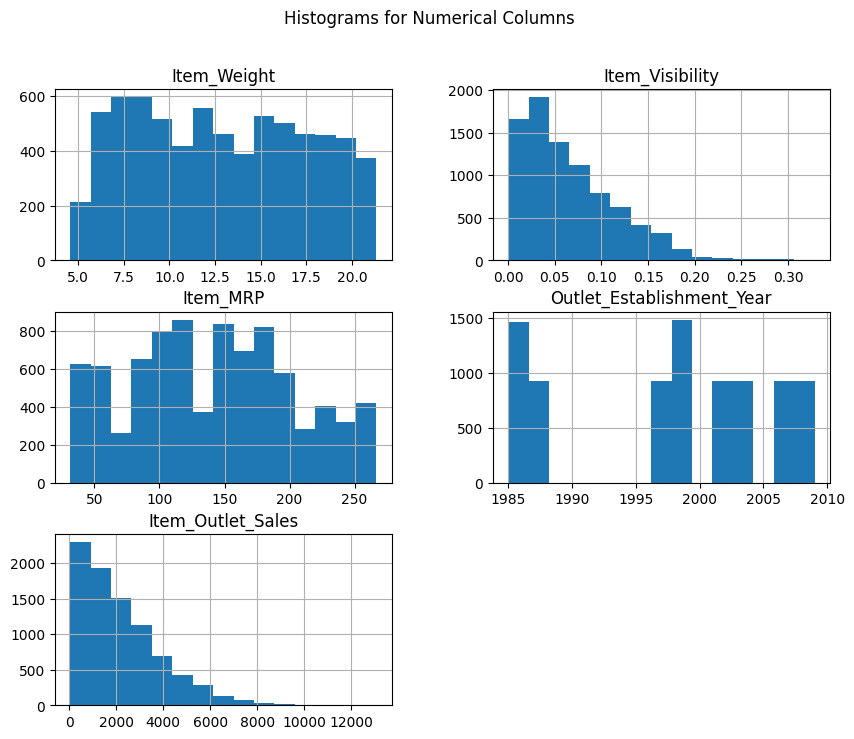

In [6]:
# Step 4: Visualize histograms for each numerical column

data.hist(bins=15, figsize=(10, 8))
plt.suptitle("Histograms for Numerical Columns")
plt.show()


In [7]:
# Step 5: Handle missing values

# Display the number of missing values per column
print("Number of missing values in each column before filling:")
print(data.isnull().sum())

Number of missing values in each column before filling:
Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64


In [8]:
# Save the mean values for numerical columns with missing values
mean_values_with_na = data.mean(numeric_only=True)

# Save the mode values for categorical columns with missing values
mode_values_with_na = data.mode().iloc[0]


In [9]:
# Fill missing values with the mean of numerical columns and mode of categorical columns
for column in data.columns:
    if data[column].dtype == 'object':  # Categorical columns
        if data[column].isnull().any():
            data[column].fillna(mode_values_with_na[column], inplace=True)
    else:  # Numerical columns
        if data[column].isnull().any():
            data[column].fillna(mean_values_with_na[column], inplace=True)



In [10]:
# Display the mean/mode values used to fill each column with missing values
print("\nValues used to fill columns with missing values:")
for column in data.columns:
    if data[column].dtype == 'object':  # Categorical columns
        if column in mode_values_with_na:
            print(f"{column}: {mode_values_with_na[column]}")
    else:  # Numerical columns
        if column in mean_values_with_na:
            print(f"{column}: {mean_values_with_na[column]}")



Values used to fill columns with missing values:
Item_Identifier: FDG33
Item_Weight: 12.857645184135976
Item_Fat_Content: Low Fat
Item_Visibility: 0.06613202877895108
Item_Type: Fruits and Vegetables
Item_MRP: 140.9927819781767
Outlet_Identifier: OUT027
Outlet_Establishment_Year: 1997.8318667135984
Outlet_Size: Medium
Outlet_Location_Type: Tier 3
Outlet_Type: Supermarket Type1
Item_Outlet_Sales: 2181.288913575032


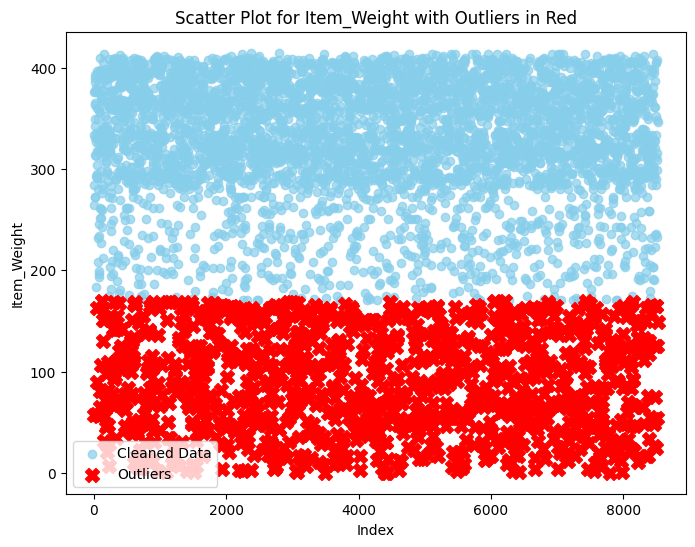


Outliers Detected for Item_Weight:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
1                   8           57                 2         0.019278   
28                350           58                 2         0.161467   
45                641           90                 0         0.089499   
50               1378          163                 1         0.067780   
79               1037           56                 1         0.000000   
...               ...          ...               ...              ...   
8496              540          165                 2         0.021696   
8501             1083           24                 2         0.005998   
8507              671           54                 2         0.030242   
8518              370          125                 1         0.056783   
8521              681          149                 2         0.145221   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
1           

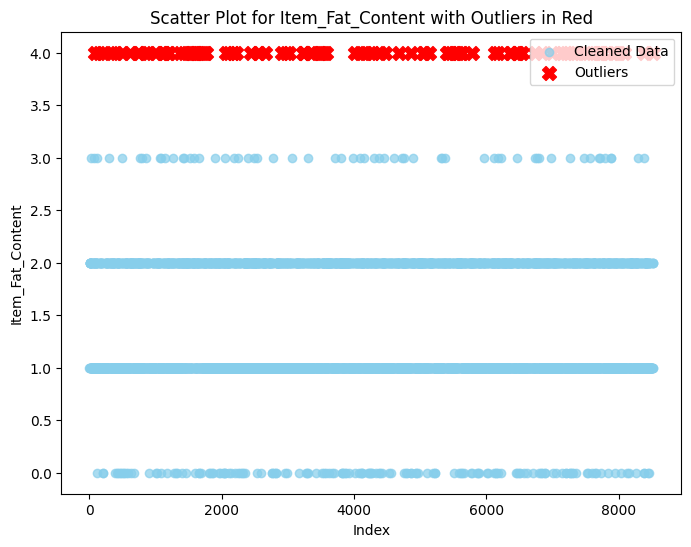


Outliers Detected for Item_Fat_Content:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
81                656          314                 4         0.014087   
151               843          336                 4         0.026002   
199              1157          326                 4         0.101339   
339               617          202                 4         0.095102   
396               689          335                 4         0.056961   
...               ...          ...               ...              ...   
7944              724          299                 4         0.033052   
8004              232          404                 4         0.018911   
8085              186          363                 4         0.128622   
8387              924          368                 4         0.062395   
8517              389          409                 4         0.083607   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
81     

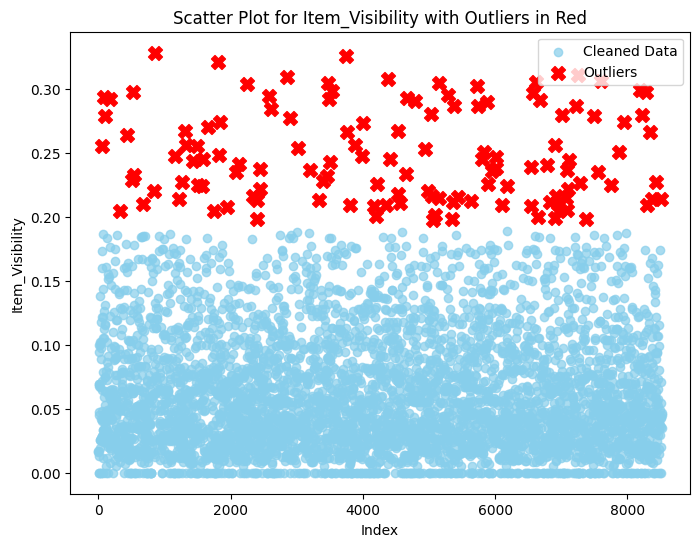


Outliers Detected for Item_Visibility:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
49                869          326                 2         0.255395   
83               1379          326                 1         0.293418   
108                36          326                 3         0.278974   
174               488          378                 1         0.291865   
334               263          326                 1         0.204700   
...               ...          ...               ...              ...   
8292              390          326                 2         0.209163   
8345             1189          326                 2         0.266397   
8371                2          224                 2         0.214125   
8432              479          337                 2         0.227261   
8509              420          215                 1         0.214306   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
49      

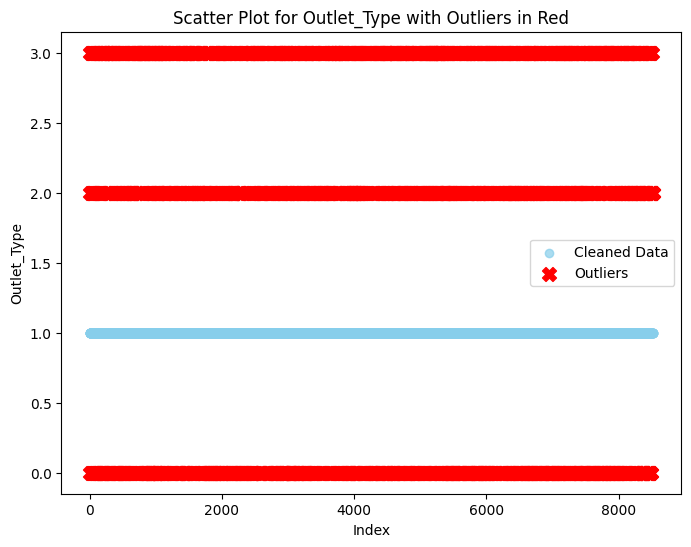


Outliers Detected for Outlet_Type:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
3                1121          393                 2         0.000000   
5                 758          297                 2         0.000000   
7                 738          326                 1         0.127470   
16               1280          314                 1         0.008596   
18                 79          326                 1         0.034238   
...               ...          ...               ...              ...   
8505              224          298                 2         0.094146   
8506               45          374                 1         0.084676   
8511              359          376                 1         0.026980   
8515              445          408                 1         0.021518   
8516             1356          387                 1         0.118661   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
3           

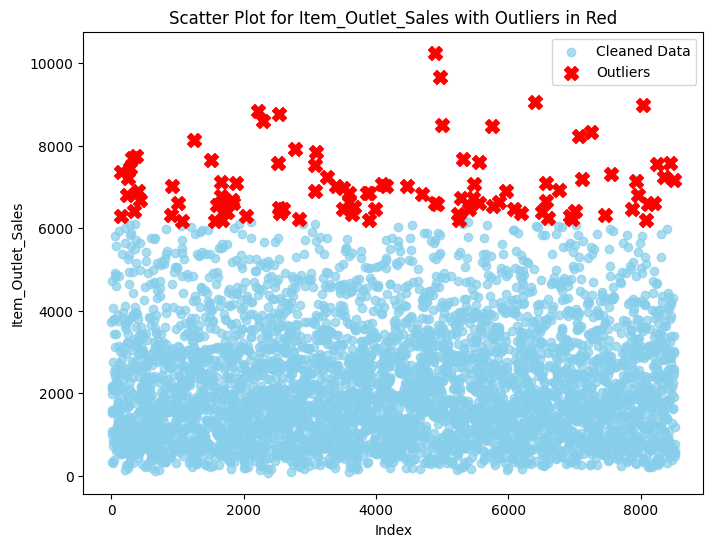


Outliers Detected for Item_Outlet_Sales:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
145               743          387                 1         0.039356   
146               198          361                 1         0.060837   
240              1472          374                 1         0.113749   
243              1211          365                 2         0.062764   
276              1210          369                 1         0.081253   
...               ...          ...               ...              ...   
8208              629          293                 1         0.038905   
8245             1011          363                 1         0.035967   
8350             1306          293                 1         0.021421   
8447              889          405                 1         0.089975   
8510              689          335                 2         0.056862   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
145   

In [46]:
# Step 6: Identify and remove outliers using IQR (Interquartile Range)

outlier_columns = []
outliers_dict = {}

# Iterate over each numeric column in the dataset
for feature in data.select_dtypes(include=[np.number]).columns:
    Q1 = data[feature].quantile(0.25)  # 25th percentile
    Q3 = data[feature].quantile(0.75)  # 75th percentile
    IQR = Q3 - Q1  # Interquartile Range

    # Define outlier mask
    outlier_mask = (data[feature] < (Q1 - 1.5 * IQR)) | (data[feature] > (Q3 + 1.5 * IQR))

    # If outliers are present, store them and mark the column
    if outlier_mask.any():
        outliers_dict[feature] = data[outlier_mask]  # Store outliers for reference
        outlier_columns.append(feature)  # Keep track of columns with outliers

    # Remove outliers for the current feature
    data = data[~outlier_mask]

# Scatter plots for columns with outliers
for feature in outlier_columns:
    plt.figure(figsize=(8, 6))

    # Plot cleaned data (without outliers)
    plt.scatter(data.index, data[feature], color='skyblue', label="Cleaned Data", alpha=0.7)

    # Plot detected outliers
    if feature in outliers_dict:
        outliers = outliers_dict[feature]
        plt.scatter(outliers.index, outliers[feature], color='red', label="Outliers", s=100, marker='X')

    plt.title(f"Scatter Plot for {feature} with Outliers in Red")
    plt.xlabel('Index')
    plt.ylabel(feature)
    plt.legend()
    plt.show()

    print(f"\nOutliers Detected for {feature}:")
    print(outliers)

# Verify if dataset has been cleaned successfully
print("\nDataset after outlier removal:")
print(data.describe())



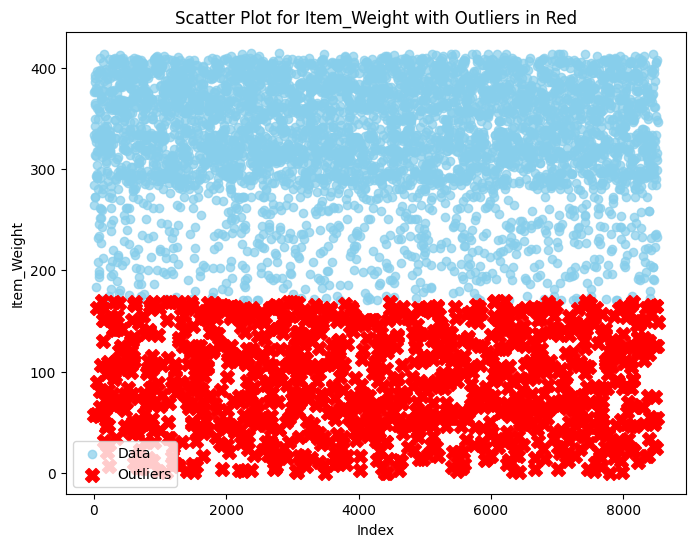


Outliers Detected for Item_Weight:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
1                   8           57                 2         0.019278   
28                350           58                 2         0.161467   
45                641           90                 0         0.089499   
50               1378          163                 1         0.067780   
79               1037           56                 1         0.000000   
...               ...          ...               ...              ...   
8496              540          165                 2         0.021696   
8501             1083           24                 2         0.005998   
8507              671           54                 2         0.030242   
8518              370          125                 1         0.056783   
8521              681          149                 2         0.145221   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
1           

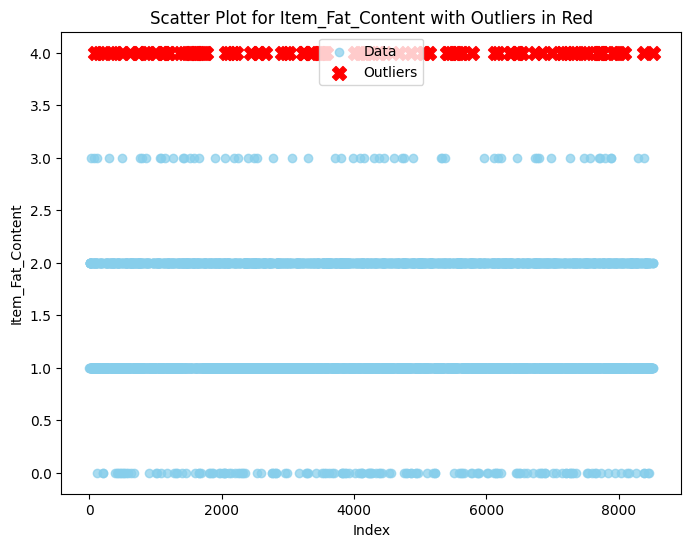


Outliers Detected for Item_Fat_Content:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
81                656          314                 4         0.014087   
151               843          336                 4         0.026002   
199              1157          326                 4         0.101339   
339               617          202                 4         0.095102   
396               689          335                 4         0.056961   
...               ...          ...               ...              ...   
7944              724          299                 4         0.033052   
8004              232          404                 4         0.018911   
8085              186          363                 4         0.128622   
8387              924          368                 4         0.062395   
8517              389          409                 4         0.083607   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
81     

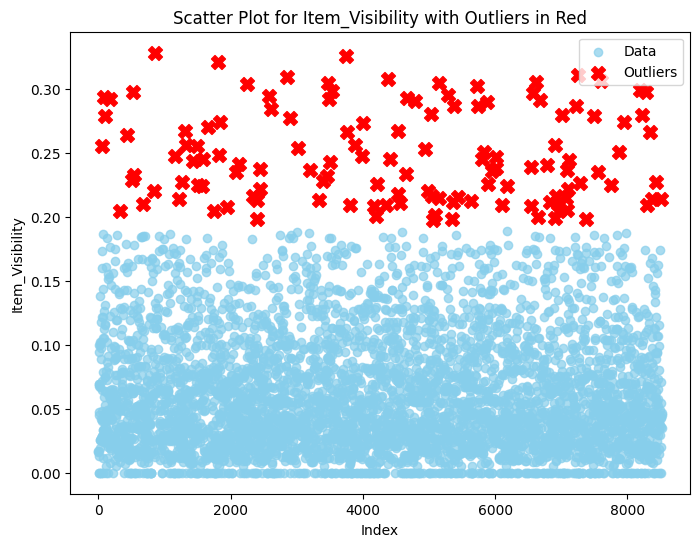


Outliers Detected for Item_Visibility:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
49                869          326                 2         0.255395   
83               1379          326                 1         0.293418   
108                36          326                 3         0.278974   
174               488          378                 1         0.291865   
334               263          326                 1         0.204700   
...               ...          ...               ...              ...   
8292              390          326                 2         0.209163   
8345             1189          326                 2         0.266397   
8371                2          224                 2         0.214125   
8432              479          337                 2         0.227261   
8509              420          215                 1         0.214306   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
49      

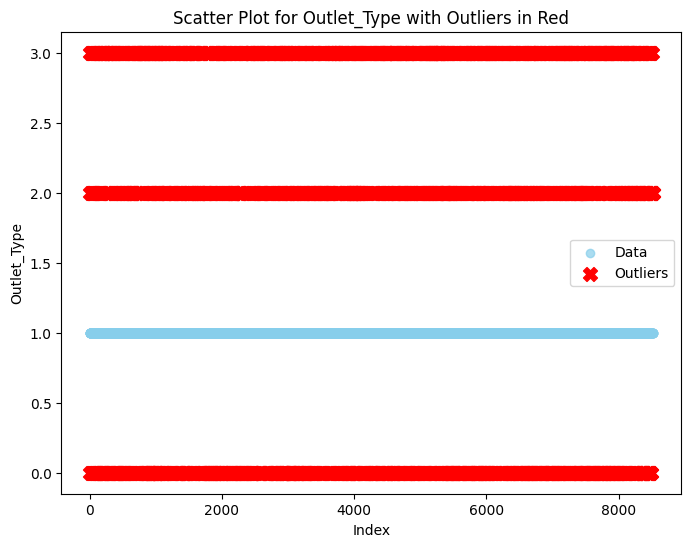


Outliers Detected for Outlet_Type:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
3                1121          393                 2         0.000000   
5                 758          297                 2         0.000000   
7                 738          326                 1         0.127470   
16               1280          314                 1         0.008596   
18                 79          326                 1         0.034238   
...               ...          ...               ...              ...   
8505              224          298                 2         0.094146   
8506               45          374                 1         0.084676   
8511              359          376                 1         0.026980   
8515              445          408                 1         0.021518   
8516             1356          387                 1         0.118661   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
3           

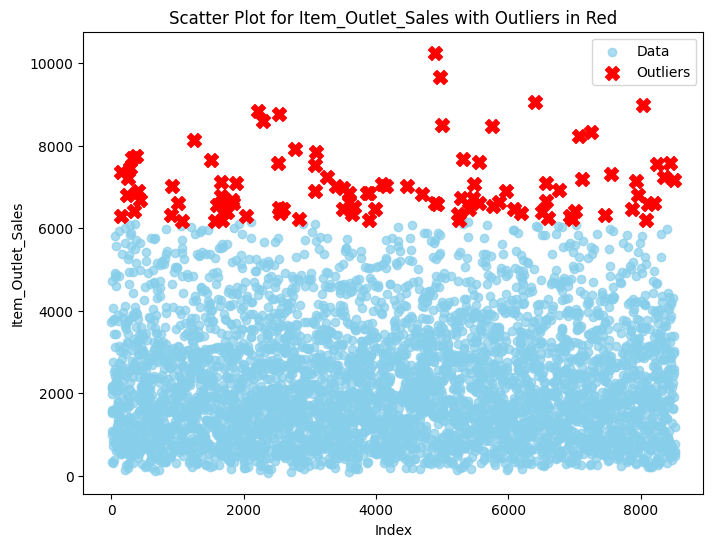


Outliers Detected for Item_Outlet_Sales:
      Item_Identifier  Item_Weight  Item_Fat_Content  Item_Visibility  \
145               743          387                 1         0.039356   
146               198          361                 1         0.060837   
240              1472          374                 1         0.113749   
243              1211          365                 2         0.062764   
276              1210          369                 1         0.081253   
...               ...          ...               ...              ...   
8208              629          293                 1         0.038905   
8245             1011          363                 1         0.035967   
8350             1306          293                 1         0.021421   
8447              889          405                 1         0.089975   
8510              689          335                 2         0.056862   

      Item_Type  Item_MRP  Outlet_Identifier  Outlet_Establishment_Year  \
145   

In [47]:
# Generate scatter plots only for the columns that contain outliers
for feature in outlier_columns:
    plt.figure(figsize=(8, 6))  # Create a figure for the scatter plot

    # Plot all data points (excluding outliers) for the feature
    non_outliers = data[~outlier_mask]  # Data without outliers
    plt.scatter(non_outliers.index, non_outliers[feature], color='skyblue', label="Data", alpha=0.7)

    # Plot the outliers in red
    outliers = outliers_dict[feature]  # Get the outliers for the current feature
    plt.scatter(outliers.index, outliers[feature], color='red', label="Outliers", s=100, marker='X')

    # Set title and labels for the plot
    plt.title(f"Scatter Plot for {feature} with Outliers in Red")
    plt.xlabel('Index')
    plt.ylabel(feature)
    plt.legend()
    plt.show()

    # Print the outliers detected for the current feature
    print(f"\nOutliers Detected for {feature}:")
    print(outliers)

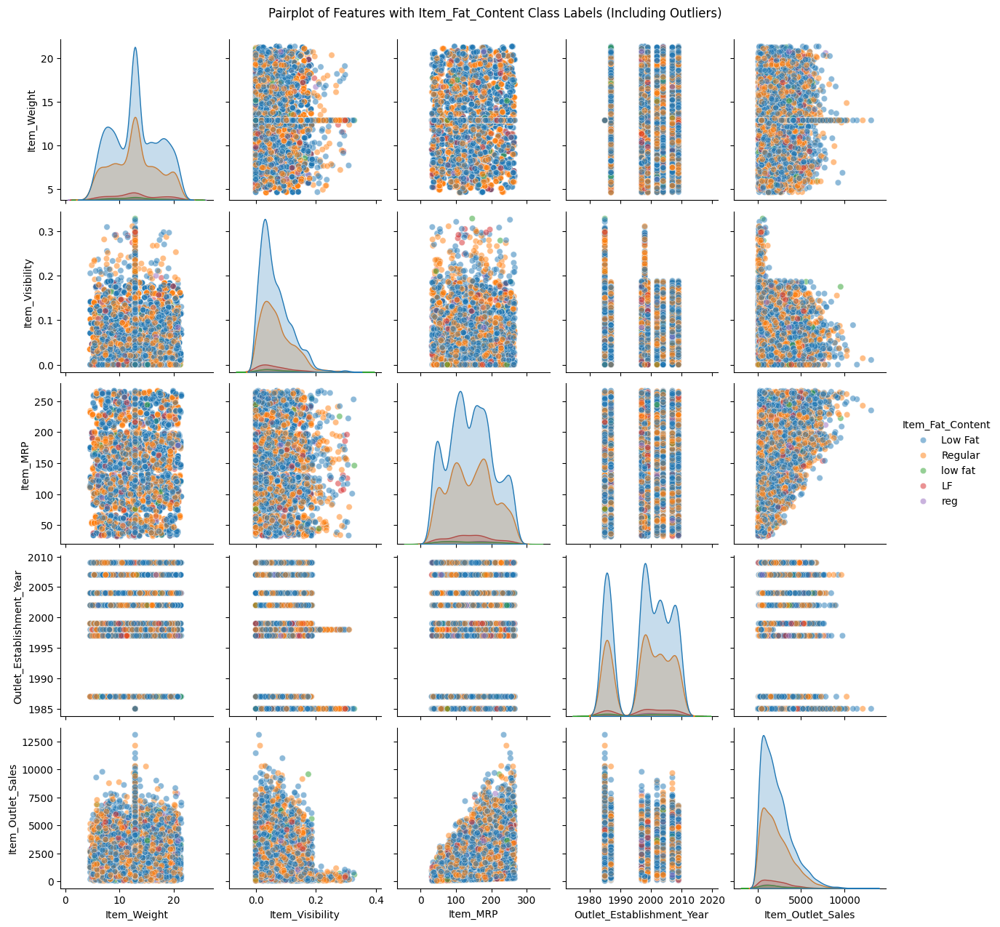

In [13]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Item_Fat_Content', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Fat_Content Class Labels (Including Outliers)", y=1.02)
plt.show()

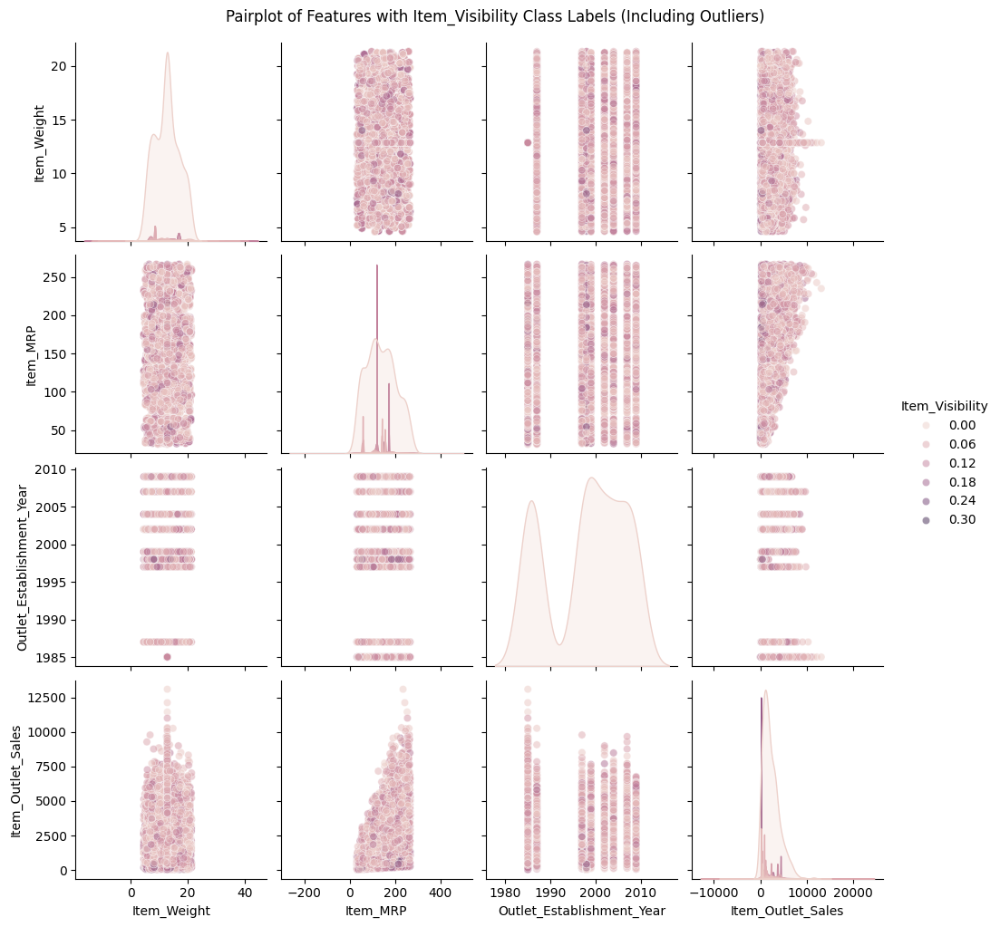

In [14]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Item_Visibility', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Visibility Class Labels (Including Outliers)", y=1.02)
plt.show()

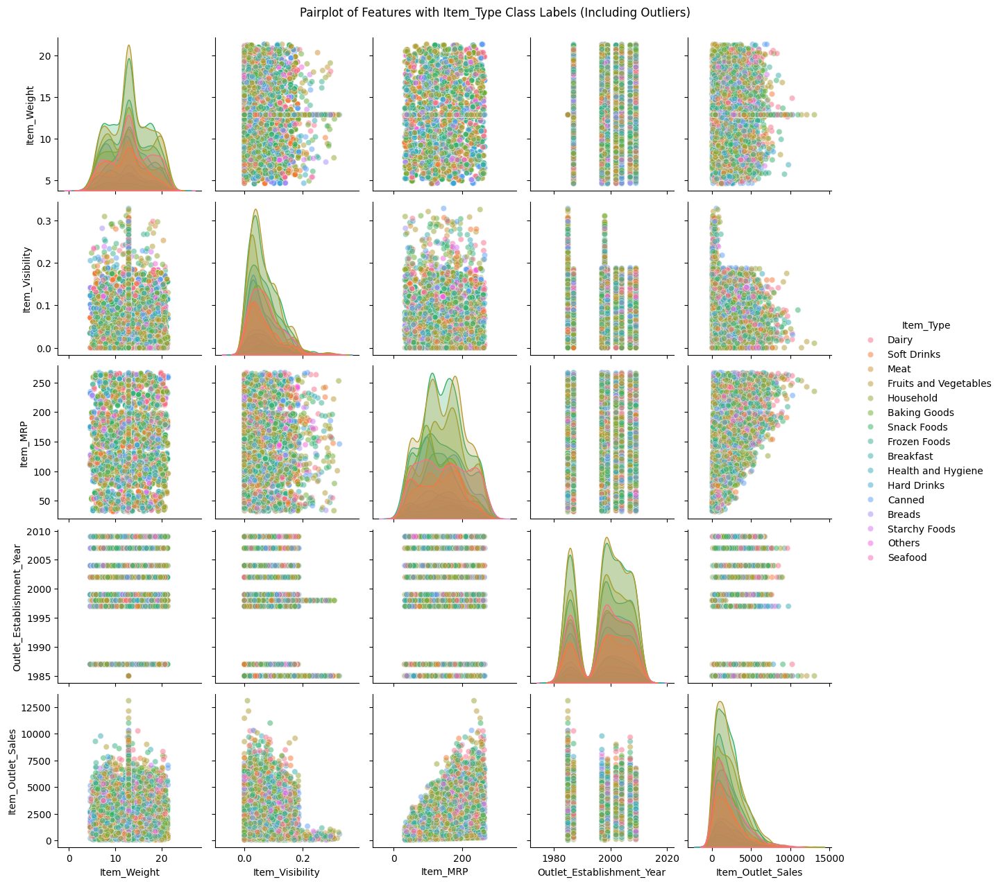

In [15]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Item_Type', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Type Class Labels (Including Outliers)", y=1.02)
plt.show()

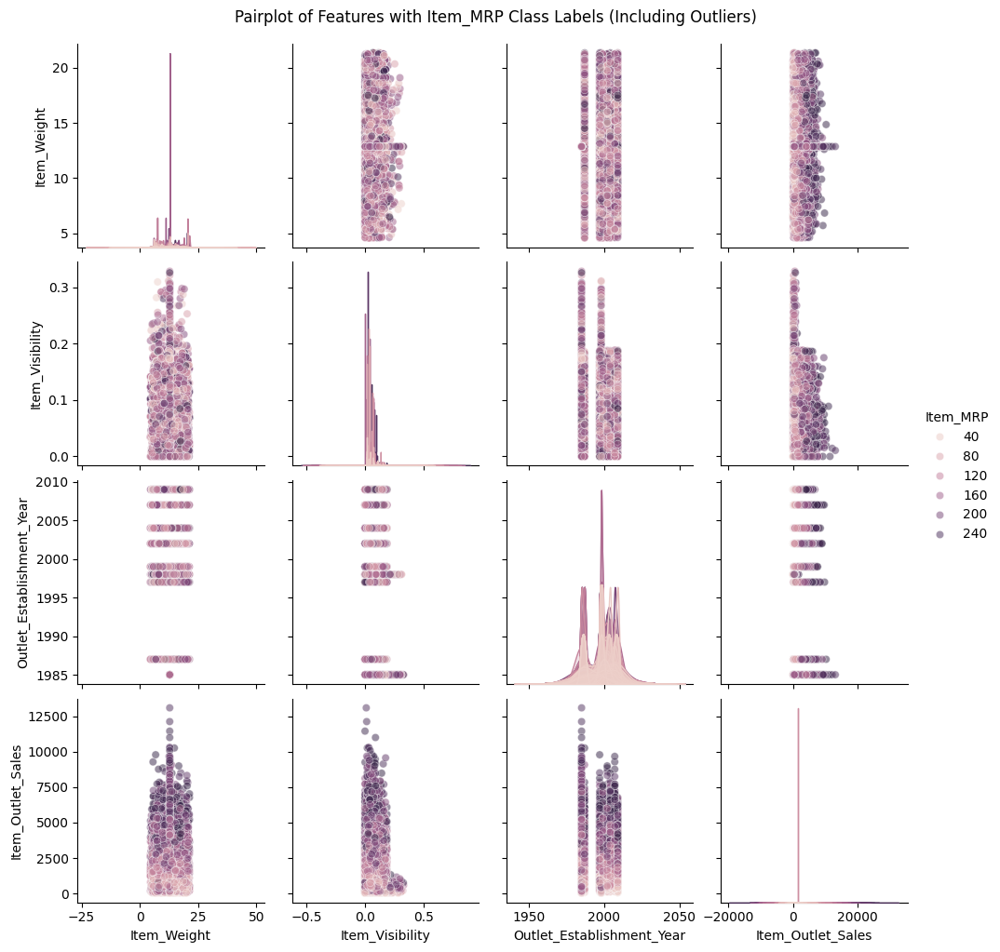

In [16]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Item_MRP', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_MRP Class Labels (Including Outliers)", y=1.02)
plt.show()

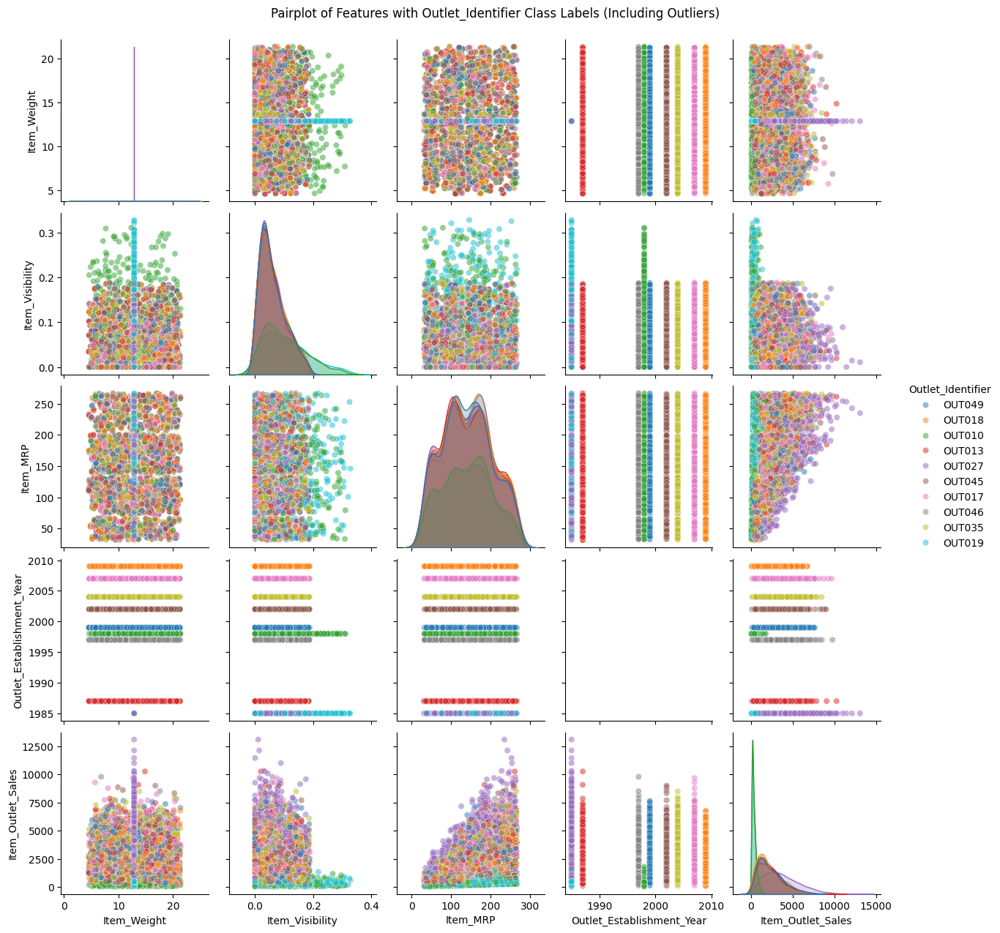

In [17]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Outlet_Identifier', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Identifier Class Labels (Including Outliers)", y=1.02)
plt.show()

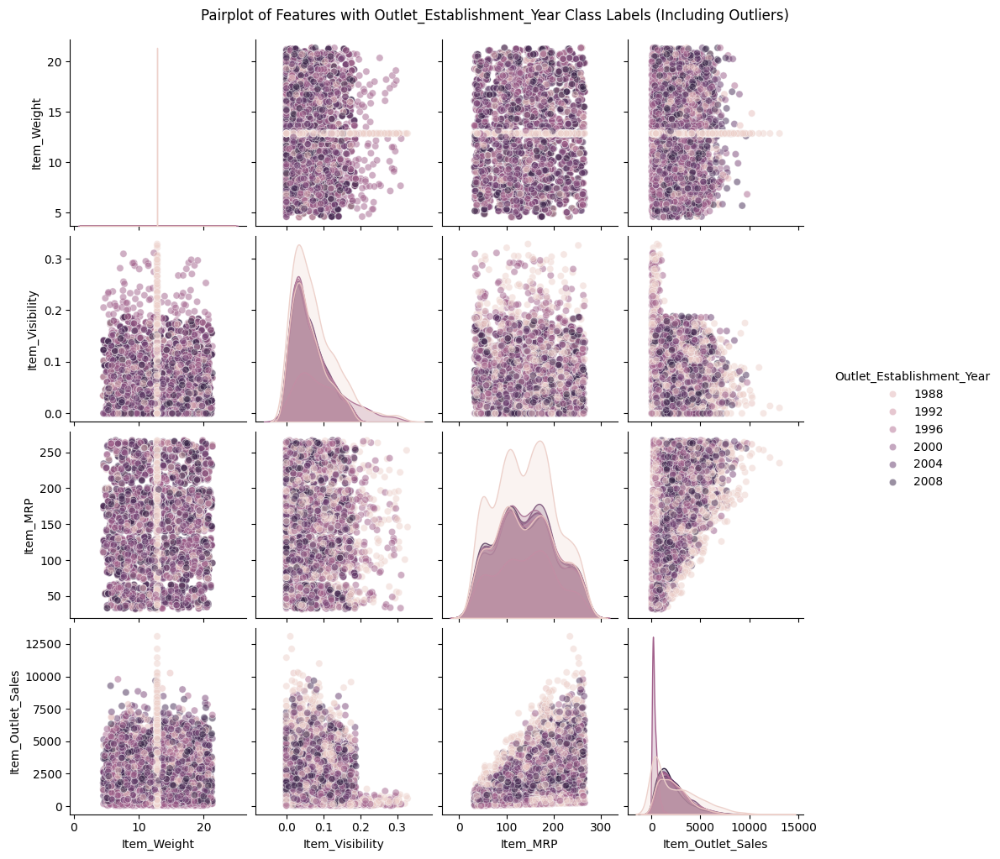

In [18]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Outlet_Establishment_Year', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Establishment_Year Class Labels (Including Outliers)", y=1.02)
plt.show()


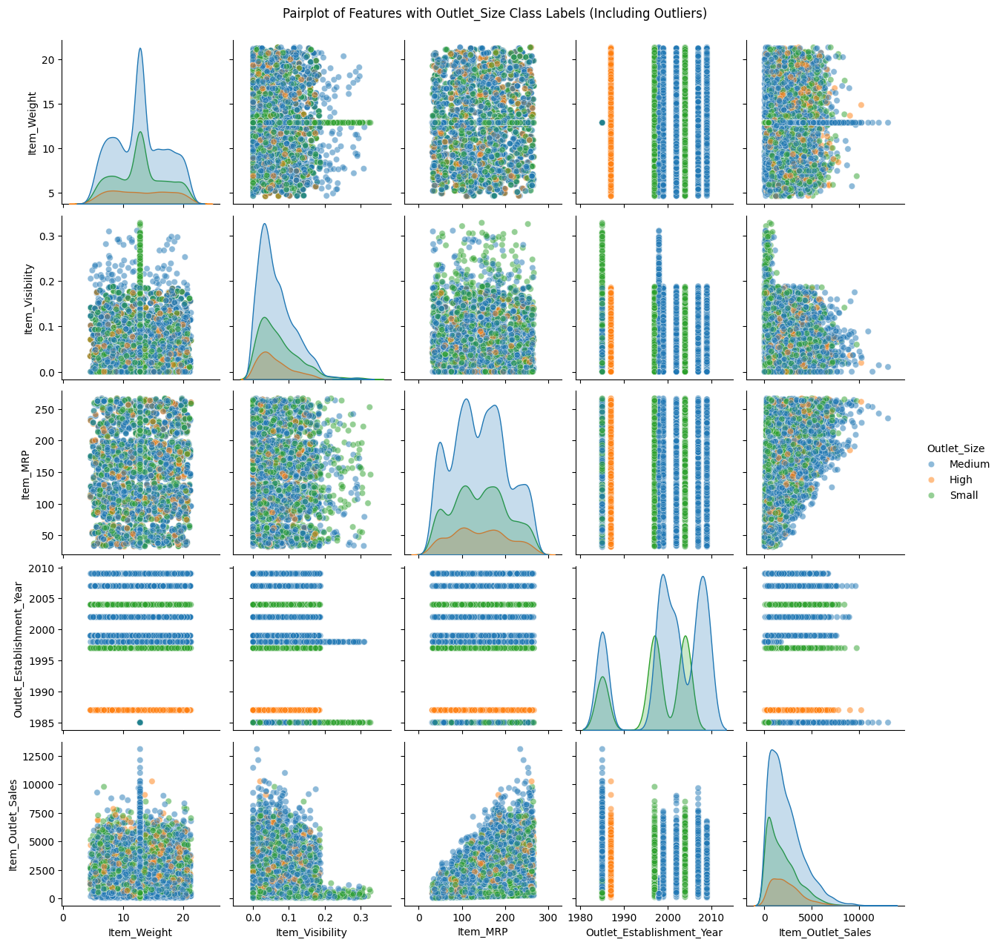

In [19]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Outlet_Size', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Size Class Labels (Including Outliers)", y=1.02)
plt.show()


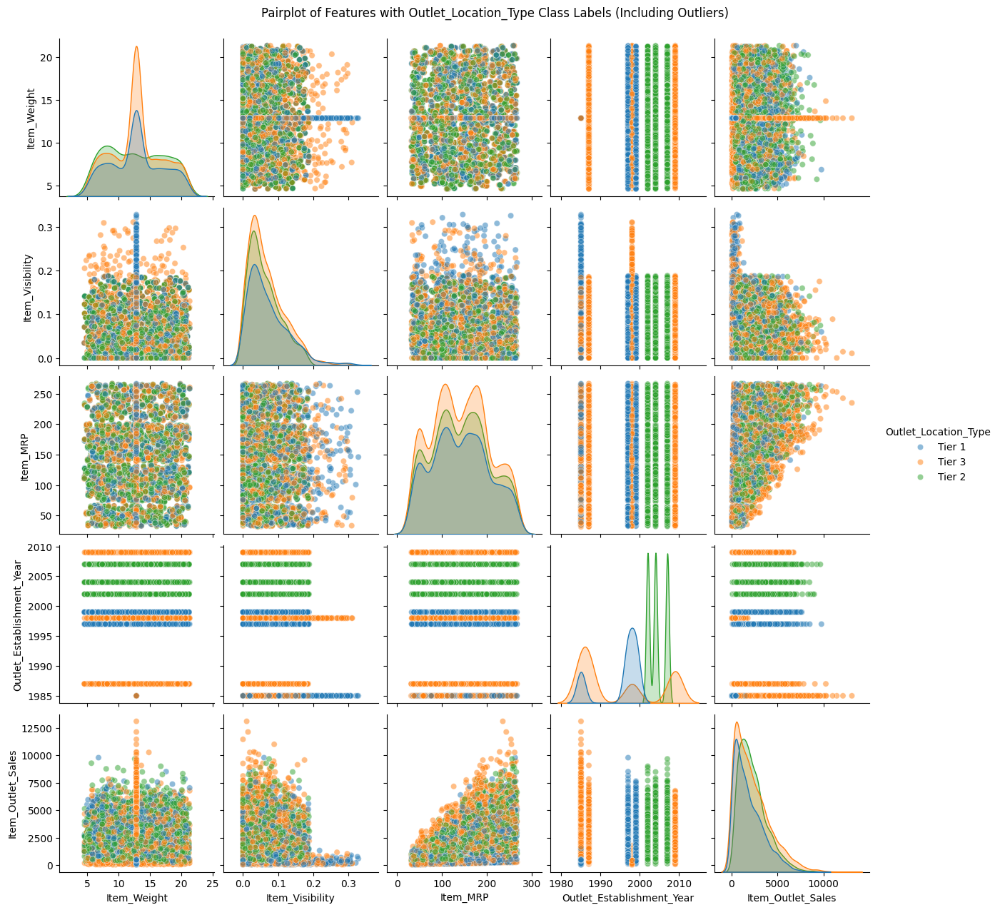

In [20]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Outlet_Location_Type', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Location_Type Class Labels (Including Outliers)", y=1.02)
plt.show()

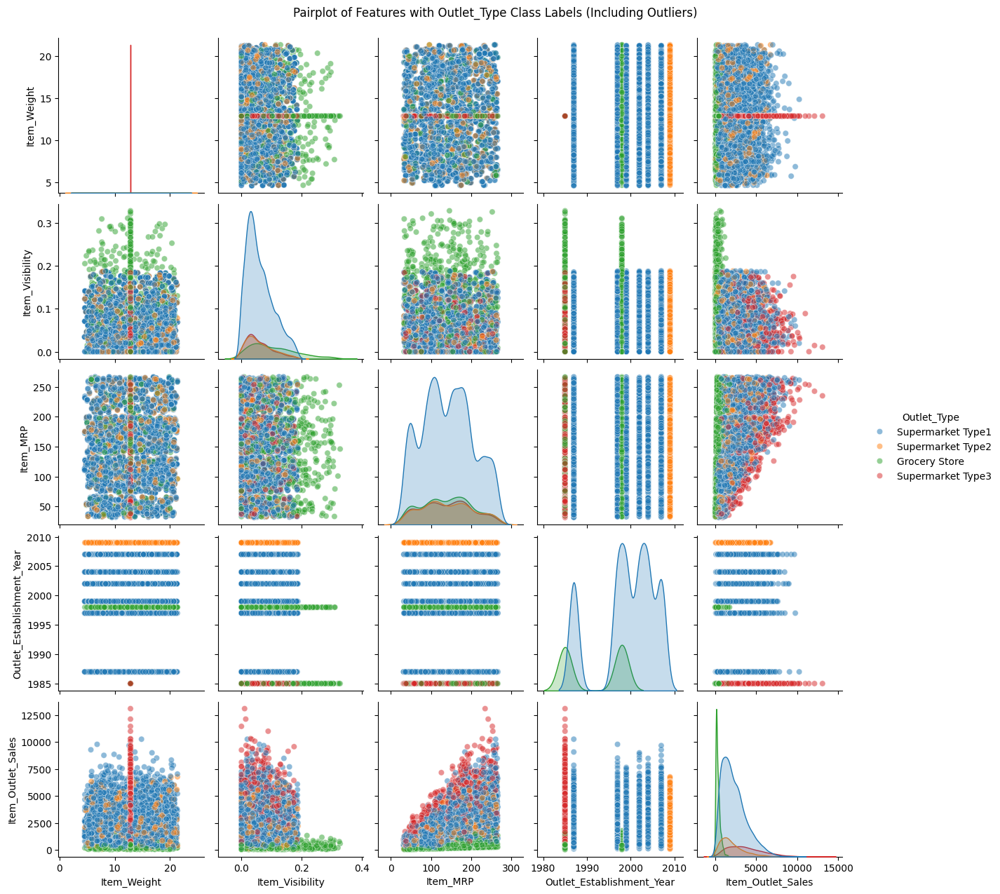

In [21]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Outlet_Type', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Type Class Labels (Including Outliers)", y=1.02)
plt.show()

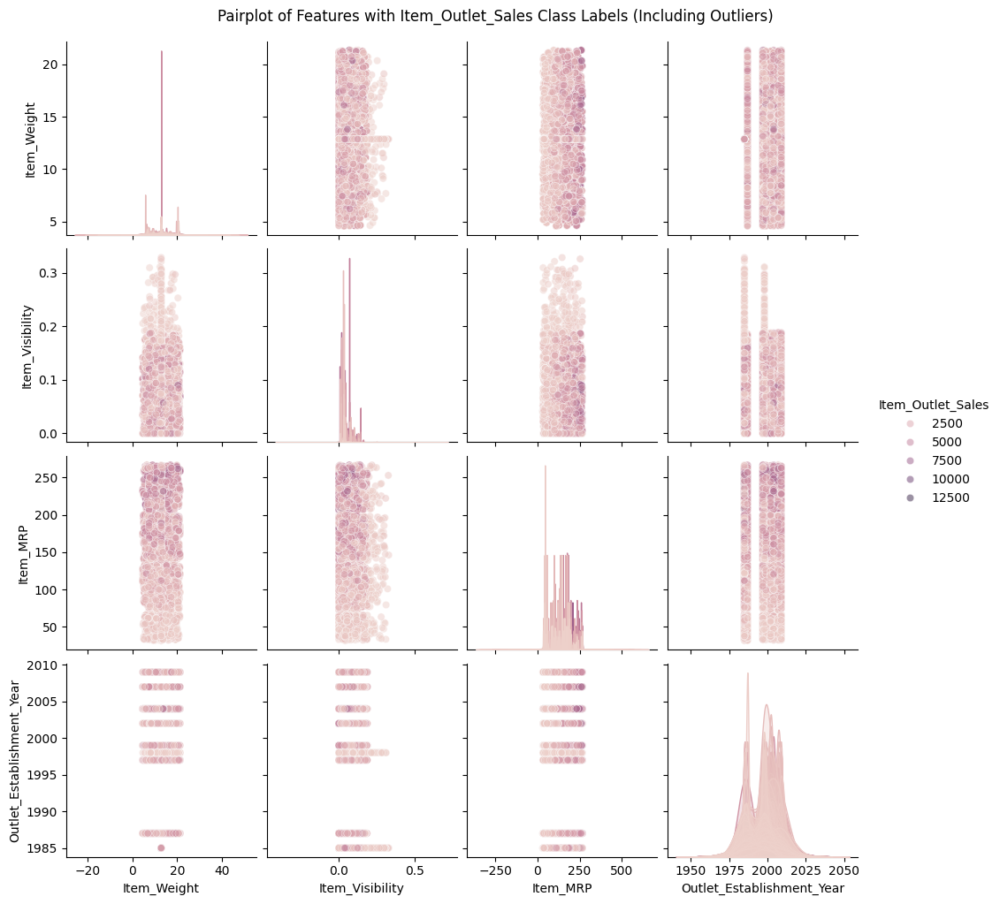

In [22]:
# Visualize the original data with a pairplot (including outliers)
sns.pairplot(data, hue='Item_Outlet_Sales', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Outlet_Sales Class Labels (Including Outliers)", y=1.02)
plt.show()

In [23]:
# Remove the outliers from the dataset

cleaned_data = data.copy()

# Loop through outlier columns to remove outliers
for feature in outlier_columns:
    outliers = outliers_dict[feature]  # Get outliers for the current feature
    cleaned_data = cleaned_data[~cleaned_data.index.isin(outliers.index)]  # Remove rows with outliers


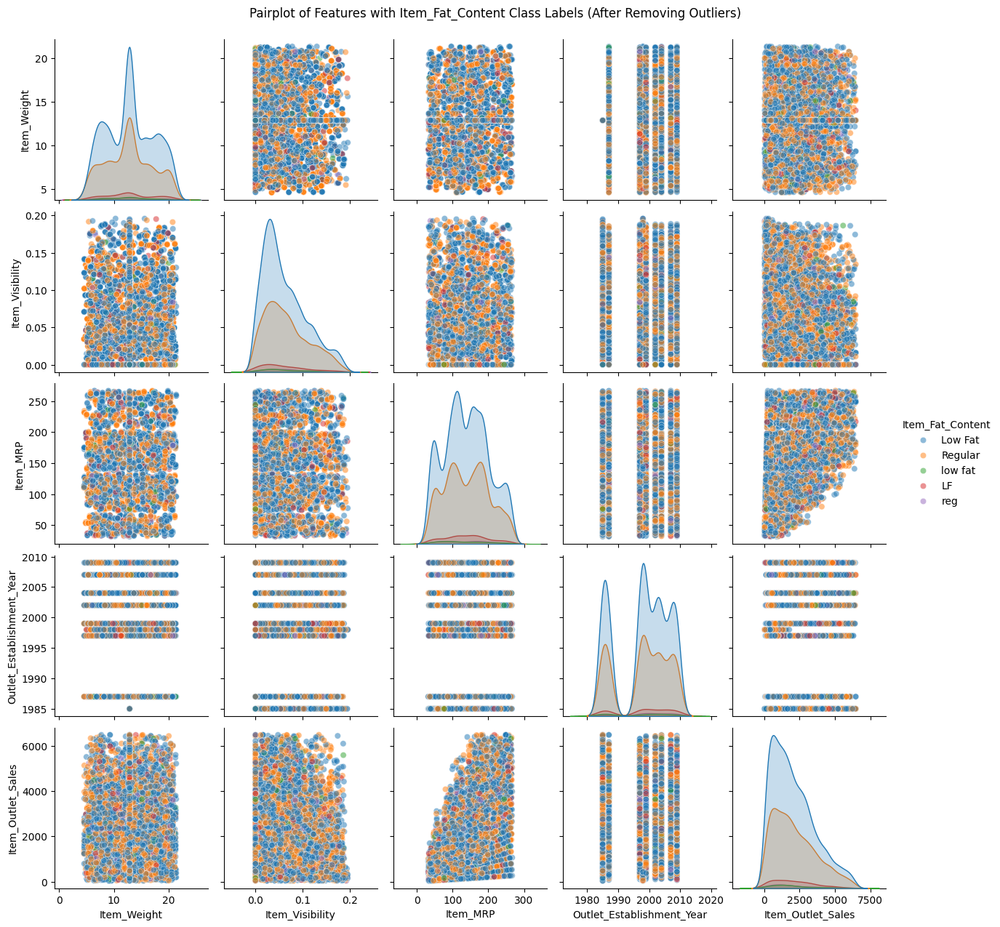

In [24]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Item_Fat_Content', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Fat_Content Class Labels (After Removing Outliers)", y=1.02)
plt.show()

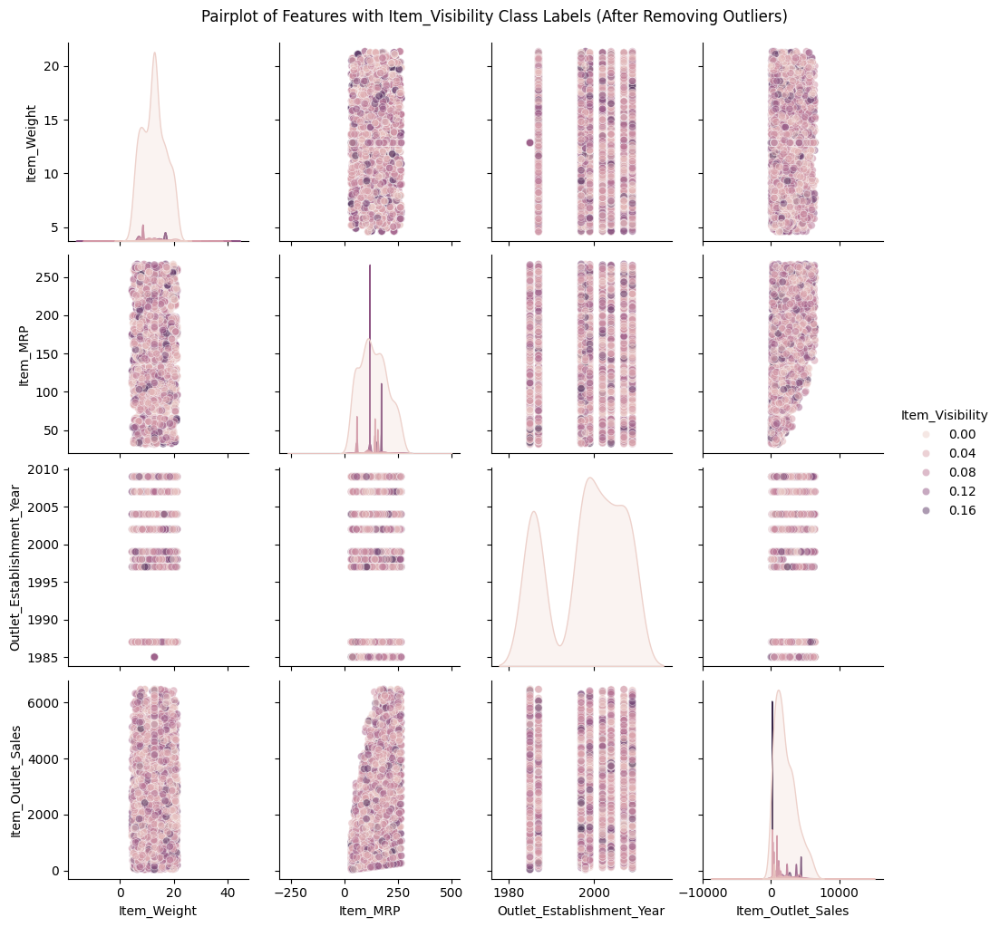

In [25]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Item_Visibility', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Visibility Class Labels (After Removing Outliers)", y=1.02)
plt.show()

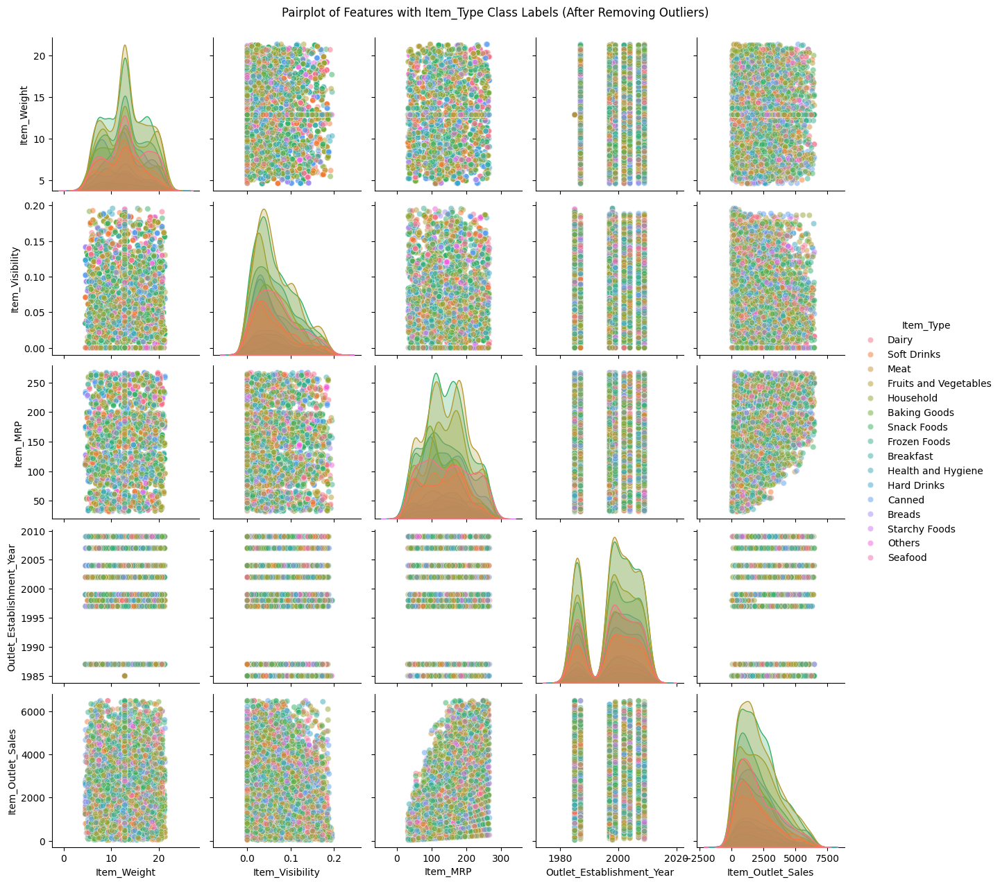

In [26]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Item_Type', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Type Class Labels (After Removing Outliers)", y=1.02)
plt.show()


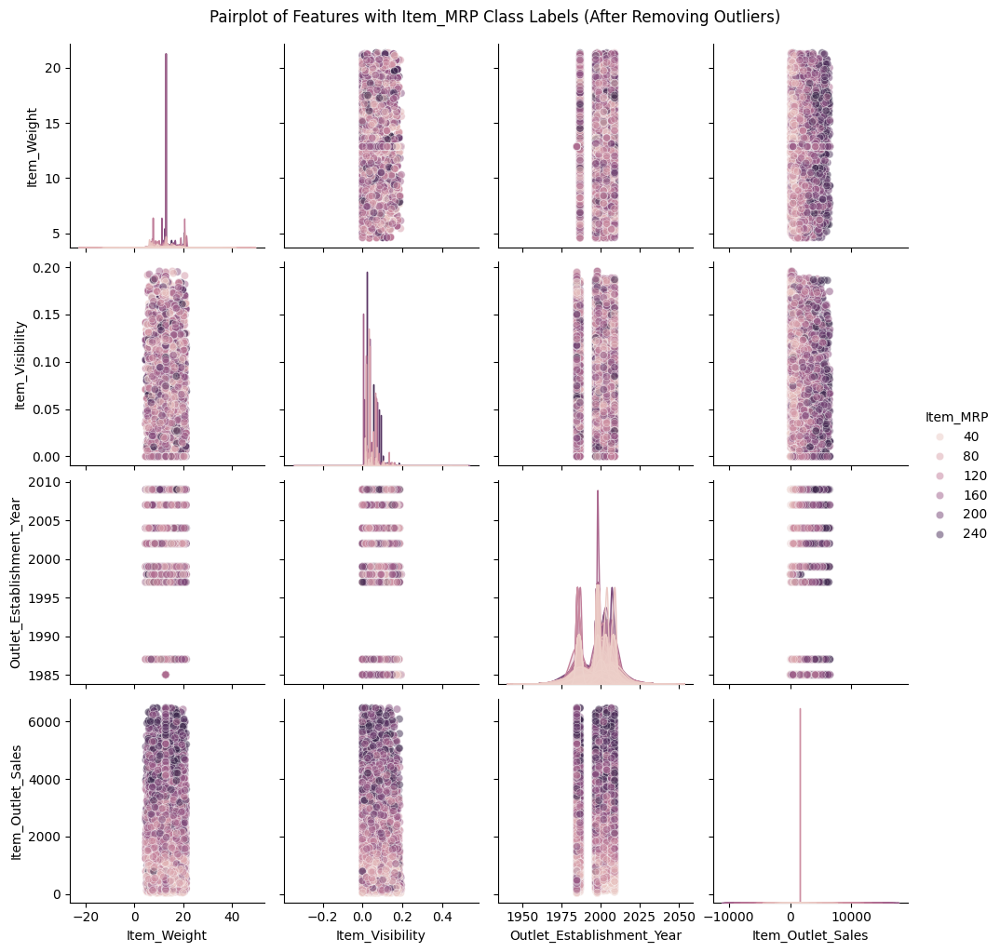

In [27]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Item_MRP', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_MRP Class Labels (After Removing Outliers)", y=1.02)
plt.show()

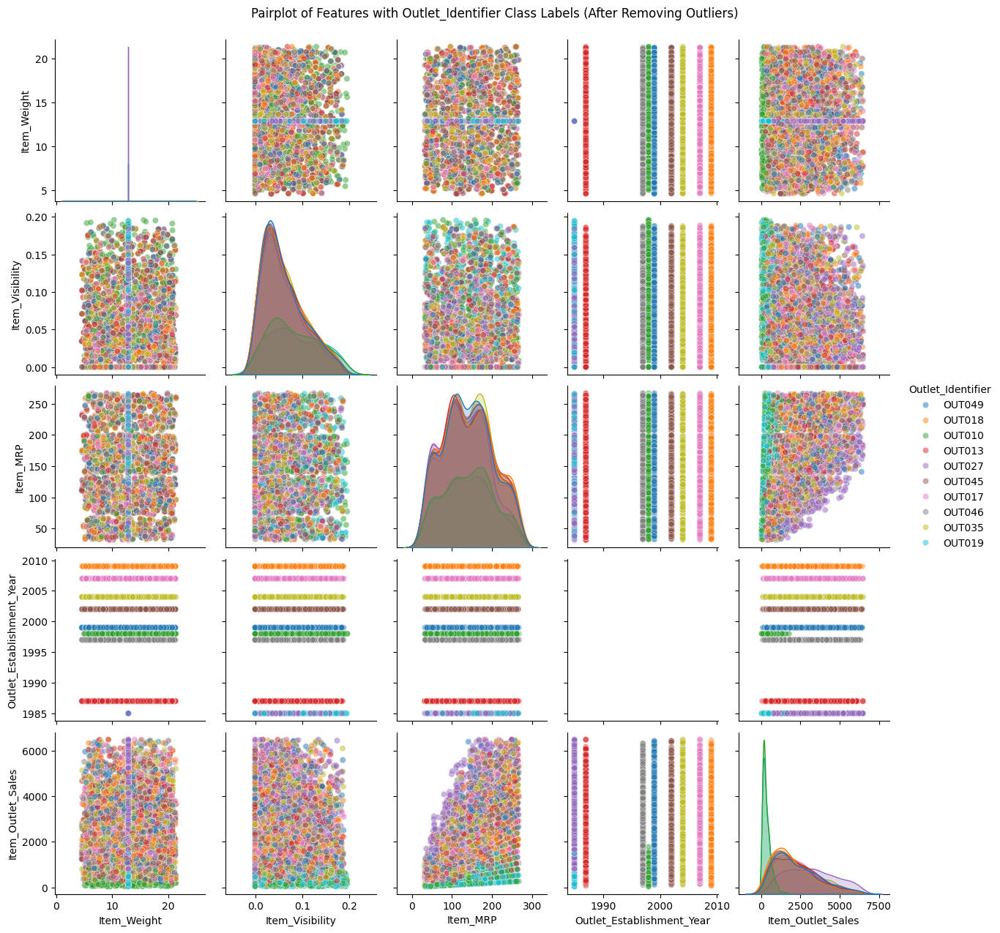

In [28]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Outlet_Identifier', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Identifier Class Labels (After Removing Outliers)", y=1.02)
plt.show()

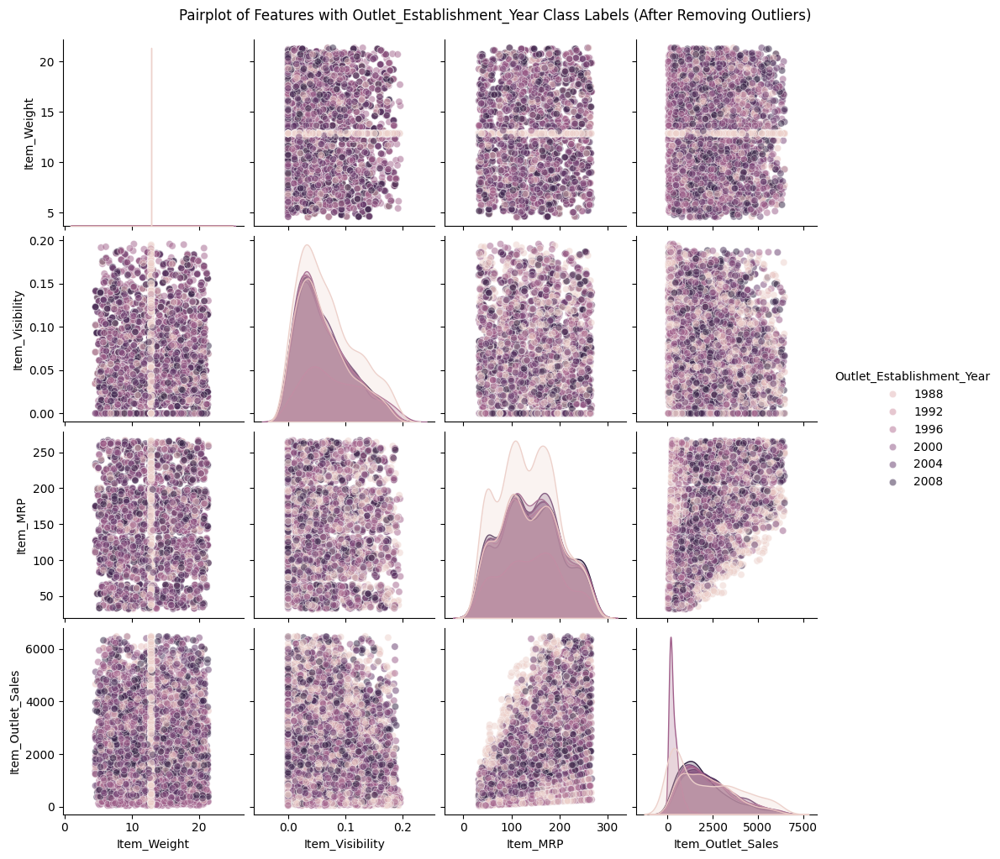

In [29]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Outlet_Establishment_Year', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Establishment_Year Class Labels (After Removing Outliers)", y=1.02)
plt.show()

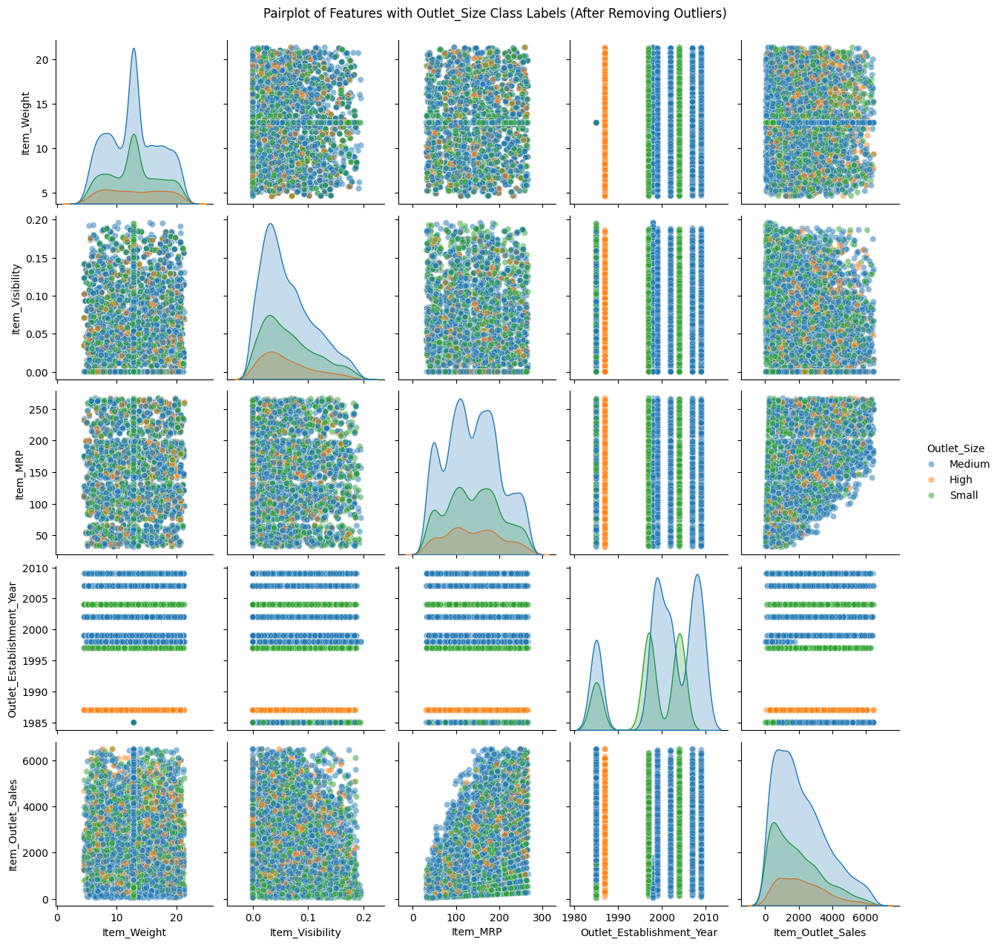

In [30]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Outlet_Size', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Size Class Labels (After Removing Outliers)", y=1.02)
plt.show()


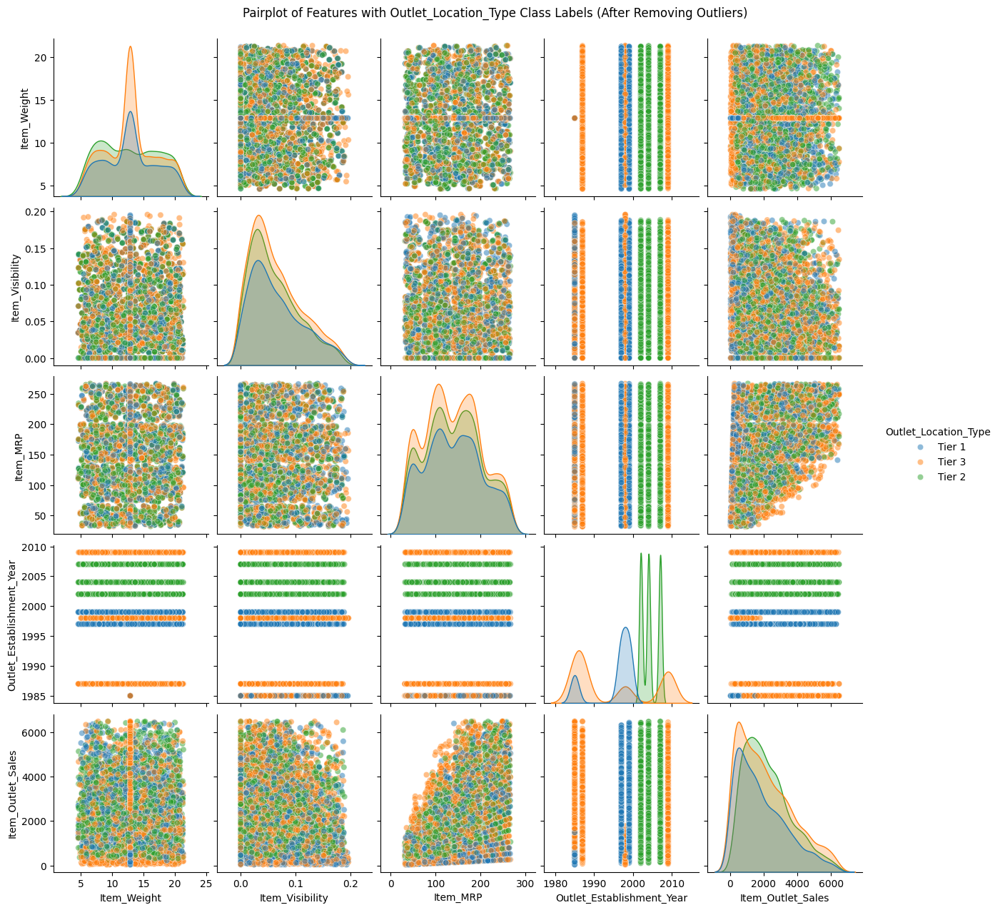

In [31]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Outlet_Location_Type', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Location_Type Class Labels (After Removing Outliers)", y=1.02)
plt.show()

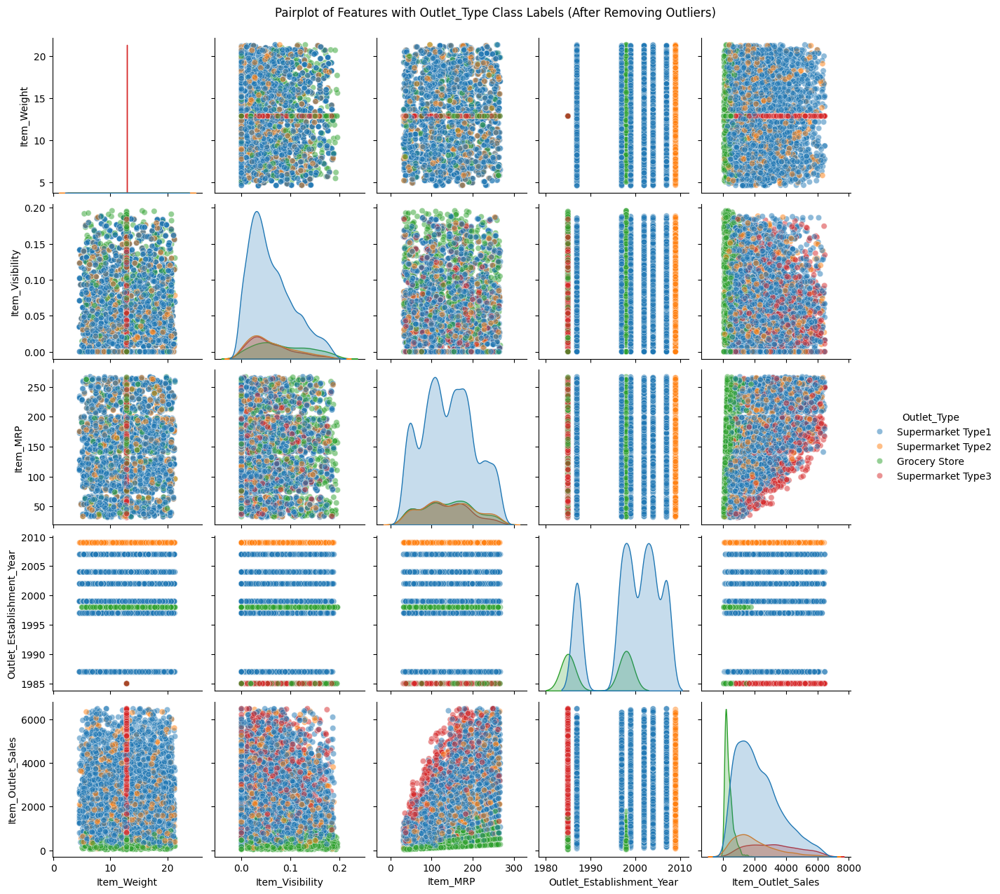

In [32]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Outlet_Type', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Outlet_Type Class Labels (After Removing Outliers)", y=1.02)
plt.show()

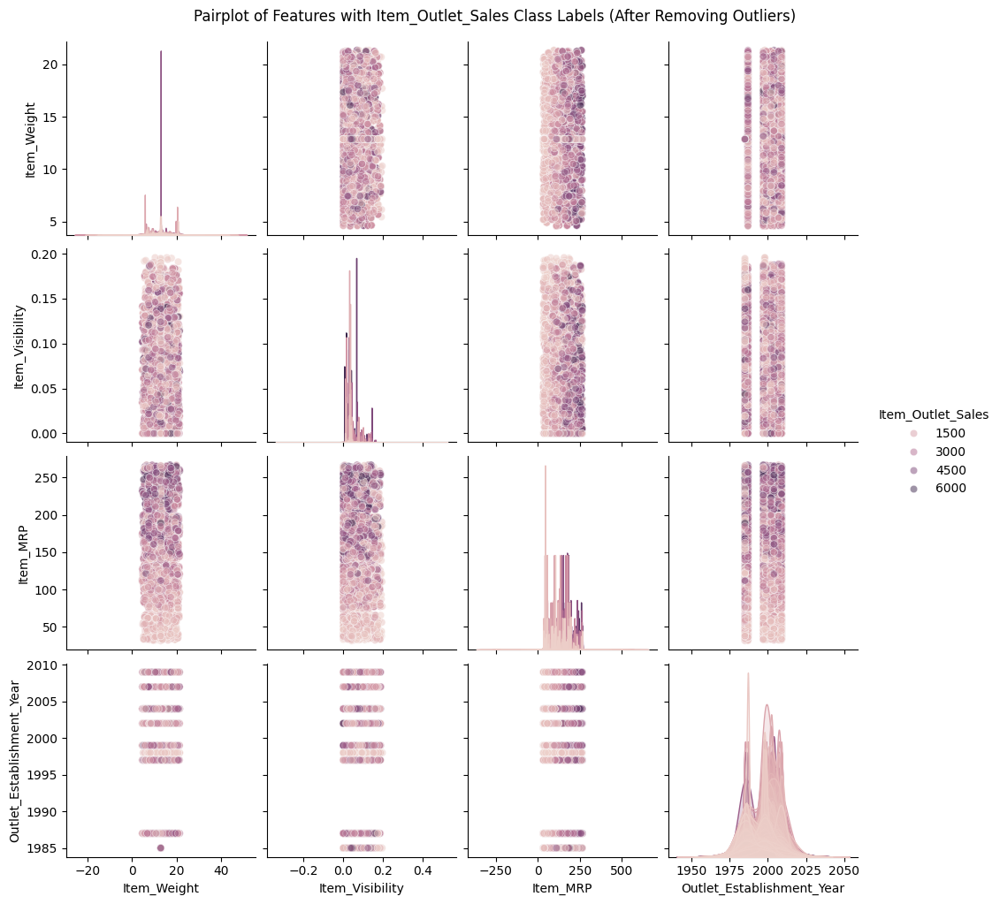

In [33]:
# Visualize the cleaned data with a pairplot (after removing outliers)
sns.pairplot(cleaned_data, hue='Item_Outlet_Sales', plot_kws={'alpha': 0.5})
plt.suptitle("Pairplot of Features with Item_Outlet_Sales Class Labels (After Removing Outliers)", y=1.02)
plt.show()

In [48]:
# Step 9: Handle non-numeric columns in X

# Convert categorical features to numeric using one-hot encoding or label encoding
# Here we use LabelEncoder for each categorical column (excluding the target 'Loan_Status')
for column in data.select_dtypes(include=['object']).columns:
    if column != 'Item_Weight':  # Avoid encoding the target variable
        label_encoder = LabelEncoder()
        data[column] = label_encoder.fit_transform(data[column])

In [49]:
# Step 10: Define features (X) and target (y)

X = data.drop(columns=['Item_Weight'])
y = data['Item_Weight']

In [50]:
# Step 11: Split data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 12: Feature scaling

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


In [51]:
# Step 12: Model selection and training

# Logistic Regression (for classification, if target is categorical)
logistic_model = LogisticRegression()
logistic_model.fit(X_train, y_train)

# Decision Tree (if target is categorical, else use DecisionTreeRegressor for regression)
tree_model = DecisionTreeClassifier(random_state=42)
tree_model.fit(X_train, y_train)

# Random Forest (same, use RandomForestRegressor for regression if target is continuous)
rf_model = RandomForestClassifier(random_state=42, n_estimators=100)
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [52]:
# Step 13: Model evaluation
models = {
    "Logistic Regression": logistic_model,
    "Decision Tree": tree_model,
    "Random Forest": rf_model
}

In [53]:
# Step 14: Display metrics

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
conf_matrices = {}
class_reports = {}

# Calculate metrics for each model
for model_name, model in models.items():
    pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, pred)
    precision = precision_score(y_test, pred, average="weighted", zero_division=1)
    recall = recall_score(y_test, pred, average="weighted", zero_division=1)
    f1 = f1_score(y_test, pred, average="weighted")

    # Append metric scores
    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)

    # Store confusion matrices and classification reports if needed
    conf_matrices[model_name] = confusion_matrix(y_test, pred)
    class_reports[model_name] = classification_report(y_test, pred)

In [54]:
# Print out results (or use them for further analysis)
print("Accuracy scores:", accuracy_scores)
print("Precision scores:", precision_scores)
print("Recall scores:", recall_scores)
print("F1 scores:", f1_scores)

Accuracy scores: [0.030871003307607496, 0.7111356119073869, 0.6527012127894156]
Precision scores: [0.4080077503732417, 0.7787023156923928, 0.7134456967033658]
Recall scores: [0.030871003307607496, 0.7111356119073869, 0.6527012127894156]
F1 scores: [0.018117803424605616, 0.7108689543604014, 0.6463949329731565]


In [41]:
# Creating the DataFrame with the metrics
metrics_df = pd.DataFrame({
    "Model": list(models.keys()),
    "Accuracy": accuracy_scores,
    "Precision": precision_scores,
    "Recall": recall_scores,
    "F1 Score": f1_scores
})

# Melt the DataFrame for easier plotting with Seaborn
metrics_melted = metrics_df.melt(id_vars="Model", var_name="Metric", value_name="Score")


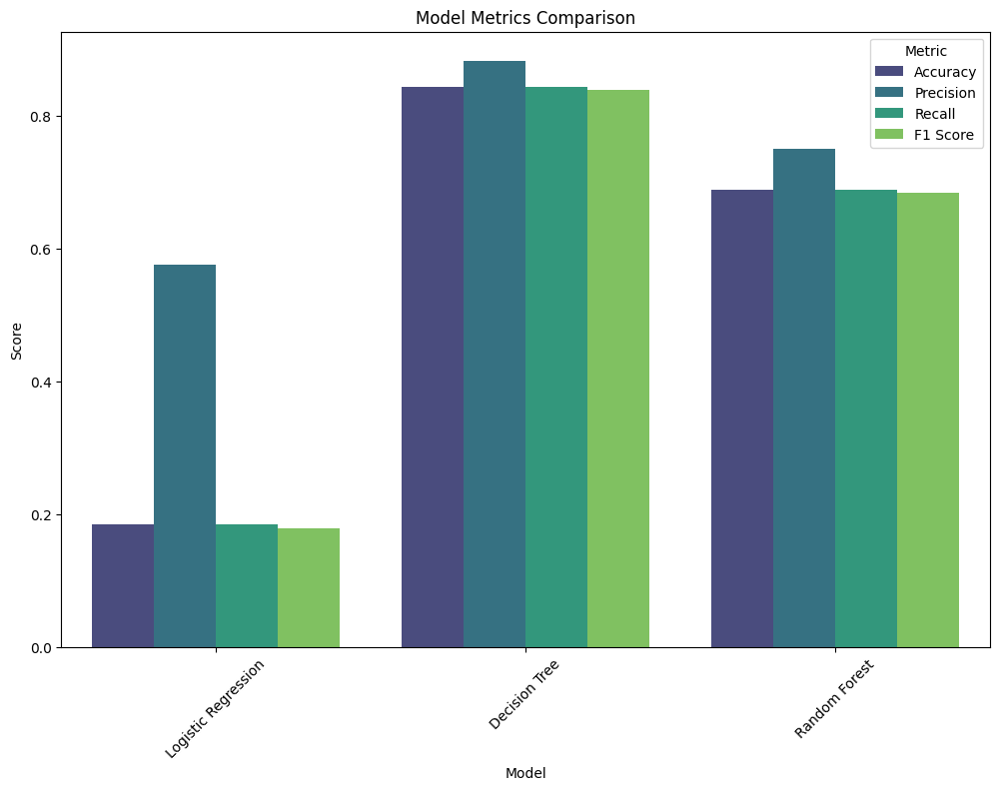

{'Logistic Regression': array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]]), 'Decision Tree': array([[2, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 2, 0],
       [0, 0, 0, ..., 0, 0, 0]]), 'Random Forest': array([[1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 0, 2, 0],
       [0, 0, 0, ..., 0, 0, 0]])}


In [55]:
# Plotting the metrics
plt.figure(figsize=(12, 8))
sns.barplot(data=metrics_melted, x="Model", y="Score", hue="Metric", palette="viridis")
plt.title("Model Metrics Comparison")
plt.xlabel("Model")
plt.ylabel("Score")
plt.xticks(rotation=45)
plt.legend(title="Metric")
plt.show()

print(conf_matrices)

In [60]:
# Print confusion matrices and classification reports
print(conf_matrices)
print(class_reports)


{'Logistic Regression': array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]]), 'Decision Tree': array([[2, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 2, 0],
       [0, 0, 0, ..., 0, 0, 0]]), 'Random Forest': array([[1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 0, 2, 0],
       [0, 0, 0, ..., 0, 0, 0]])}
{'Logistic Regression': '              precision    recall  f1-score   support\n\n         171       0.00      0.00      0.00         6\n         173       0.00      0.00      0.00         3\n         174       0.00      0.00      0.00         3\n         175       0.00      0.00      0.00         2\n         178       0.0

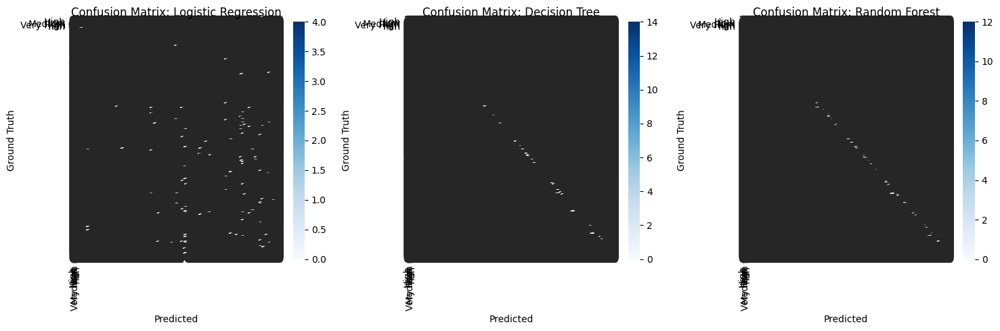

In [63]:
y_test_labels = np.unique(y_test.astype(str))  # Convert to string

# Step 14: Display Confusion Matrices

# Create the figure with subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Iterate over each model and plot the confusion matrix
for i, (model_name, model) in enumerate(models.items()):
    # Get predictions for the test set
    pred = model.predict(X_test)

    # Generate the confusion matrix
    cm = conf_matrices[model_name]

    # Plot the confusion matrix using seaborn heatmap
    sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', cbar=True,
                xticklabels=y_test_labels, yticklabels=y_test_labels,
                ax=axes[i], annot_kws={"size": 16})

    # Set the title and labels
    axes[i].set_title(f"Confusion Matrix: {model_name}")
    axes[i].set_xlabel('Predicted')
    axes[i].set_ylabel('Ground Truth')

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [44]:
# Display classification reports
for model_name, report in class_reports.items():
    print(f"\nClassification Report for {model_name}:\n{report}")


Classification Report for Logistic Regression:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         3
           2       0.00      0.00      0.00         1
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         2
           5       0.00      0.00      0.00         2
           6       0.00      0.00      0.00         1
           7       0.00      0.00      0.00         1
           9       0.00      0.00      0.00         1
          13       0.00      0.00      0.00         2
          14       0.00      0.00      0.00         2
          15       0.00      0.00      0.00         3
          17       0.00      0.00      0.00         4
          18       0.00      0.00      0.00         3
          20       0.00      0.00      0.00         2
          22       0.00      0.00      0.00         1
          24       0.00      0.00      0.00         0
          25       0.00      0.00